# 📊 Sentiment Analysis using Machine Learning & Deep Learning

## 📌 Project Description

Sentiment Analysis is a Natural Language Processing (NLP) task that focuses on identifying and classifying emotions or opinions expressed in textual data. With the rapid growth of social media, online reviews, and user-generated content, understanding public sentiment has become extremely valuable for businesses and organizations.

In this project, an end-to-end **multi-class sentiment analysis system** has been developed using both **Machine Learning** and **Deep Learning** techniques. The system takes raw text as input, cleans and preprocesses it, extracts meaningful numerical features, trains multiple models, evaluates their performance, and finally deploys the best model using a **Streamlit web application** for real-time prediction.

---

## 🎯 Objective of the Project

The main objectives of this project are:

- To perform sentiment classification on textual data.
- To compare multiple traditional Machine Learning models.
- To build a Deep Learning model using BiLSTM for sequence-based learning.
- To evaluate model performance using Accuracy, Macro F1-Score, and Confusion Matrix.
- To deploy the trained model as an interactive web application using Streamlit.

---

## 🗂 Dataset Overview

- The dataset consists of text samples and their corresponding sentiment labels.
- It contains multiple sentiment classes (multi-class classification).
- Data cleaning, label encoding, and handling of rare classes were performed to improve model stability.

---

## ⚙️ Technologies Used

- **Programming Language:** Python  
- **Data Handling:** Pandas, NumPy  
- **Visualization:** Matplotlib, Seaborn, WordCloud  
- **Machine Learning:** Scikit-learn  
- **Deep Learning:** TensorFlow / Keras (BiLSTM)  
- **Text Processing:** NLTK  
- **Deployment:** Streamlit  

---

## 🧠 Models Implemented

### ✅ Machine Learning Models:
- Logistic Regression
- Multinomial Naive Bayes
- Linear Support Vector Machine (SVM)
- Random Forest Classifier

### ✅ Deep Learning Model:
- Bidirectional LSTM (BiLSTM) Neural Network

The best performing model is selected based on **Macro F1-Score** and overall accuracy.

---

## 🚀 Deployment

The trained model is deployed using **Streamlit**, allowing users to input any text and get real-time sentiment predictions through a web interface.

---


## Libraries

In [1]:
!pip install numpy pandas scikit-learn matplotlib seaborn nltk wordcloud
!pip install tensorflow-cpu
!pip install transformers torch


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import string
import warnings

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import accuracy_score, classification_report, f1_score, confusion_matrix

from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier

import nltk
from nltk.corpus import stopwords

from wordcloud import WordCloud

import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Bidirectional, LSTM, Dense, Dropout

warnings.filterwarnings("ignore")
sns.set(style="whitegrid")

# Download NLTK resources (run once, harmless if repeated)
nltk.download('stopwords')

# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ayush\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Loading the datasets

In [3]:
# Load the CSV
df = pd.read_csv("sentimentdataset.csv")
print("Shape:", df.shape)
print("\nColumns:", df.columns.tolist())
df.head()

Shape: (732, 15)

Columns: ['Unnamed: 0.1', 'Unnamed: 0', 'Text', 'Sentiment', 'Timestamp', 'User', 'Platform', 'Hashtags', 'Retweets', 'Likes', 'Country', 'Year', 'Month', 'Day', 'Hour']


,Unnamed: 0.1,Unnamed: 0,Text,Sentiment,Timestamp,User,Platform,Hashtags,Retweets,Likes,Country,Year,Month,Day,Hour
0,0,0,Enjoying a beautiful day at the park! ...,Positive,2023-01-15 12:30:00,User123,Twitter,#Nature #Park,15.0,30.0,USA,2023,1,15,12
1,1,1,Traffic was terrible this morning. ...,Negative,2023-01-15 08:45:00,CommuterX,Twitter,#Traffic #Morning,5.0,10.0,Canada,2023,1,15,8
2,2,2,Just finished an amazing workout! 💪 ...,Positive,2023-01-15 15:45:00,FitnessFan,Instagram,#Fitness #Workout,20.0,40.0,USA,2023,1,15,15
3,3,3,Excited about the upcoming weekend getaway! ...,Positive,2023-01-15 18:20:00,AdventureX,Facebook,#Travel #Adventure,8.0,15.0,UK,2023,1,15,18
4,4,4,Trying out a new recipe for dinner tonight. ...,Neutral,2023-01-15 19:55:00,ChefCook,Instagram,#Cooking #Food,12.0,25.0,Australia,2023,1,15,19


In [4]:
# Basic data operations

print("Data types:\n", df.dtypes, "\n")
print("Missing values per column:\n", df.isna().sum(), "\n")

print("Unique sentiments:", df['Sentiment'].unique())
print("\nSentiment value counts:\n", df['Sentiment'].value_counts())


Data types:
 Unnamed: 0.1      int64
Unnamed: 0        int64
Text             object
Sentiment        object
Timestamp        object
User             object
Platform         object
Hashtags         object
Retweets        float64
Likes           float64
Country          object
Year              int64
Month             int64
Day               int64
Hour              int64
dtype: object 

Missing values per column:
 Unnamed: 0.1    0
Unnamed: 0      0
Text            0
Sentiment       0
Timestamp       0
User            0
Platform        0
Hashtags        0
Retweets        0
Likes           0
Country         0
Year            0
Month           0
Day             0
Hour            0
dtype: int64 

Unique sentiments: [' Positive  ' ' Negative  ' ' Neutral   ' ' Anger        '
 ' Fear         ' ' Sadness      ' ' Disgust      ' ' Happiness    '
 ' Joy          ' ' Love         ' ' Amusement    ' ' Enjoyment    '
 ' Admiration   ' ' Affection    ' ' Awe          ' ' Disappointed '
 ' Surprise 

In [5]:
# Droping unnecessary columns

cols_to_drop = [col for col in df.columns if col.lower().startswith("unnamed")]
print("Dropping columns:", cols_to_drop)

df = df.drop(columns=cols_to_drop)
df.head()


Dropping columns: ['Unnamed: 0.1', 'Unnamed: 0']


,Text,Sentiment,Timestamp,User,Platform,Hashtags,Retweets,Likes,Country,Year,Month,Day,Hour
0,Enjoying a beautiful day at the park! ...,Positive,2023-01-15 12:30:00,User123,Twitter,#Nature #Park,15.0,30.0,USA,2023,1,15,12
1,Traffic was terrible this morning. ...,Negative,2023-01-15 08:45:00,CommuterX,Twitter,#Traffic #Morning,5.0,10.0,Canada,2023,1,15,8
2,Just finished an amazing workout! 💪 ...,Positive,2023-01-15 15:45:00,FitnessFan,Instagram,#Fitness #Workout,20.0,40.0,USA,2023,1,15,15
3,Excited about the upcoming weekend getaway! ...,Positive,2023-01-15 18:20:00,AdventureX,Facebook,#Travel #Adventure,8.0,15.0,UK,2023,1,15,18
4,Trying out a new recipe for dinner tonight. ...,Neutral,2023-01-15 19:55:00,ChefCook,Instagram,#Cooking #Food,12.0,25.0,Australia,2023,1,15,19


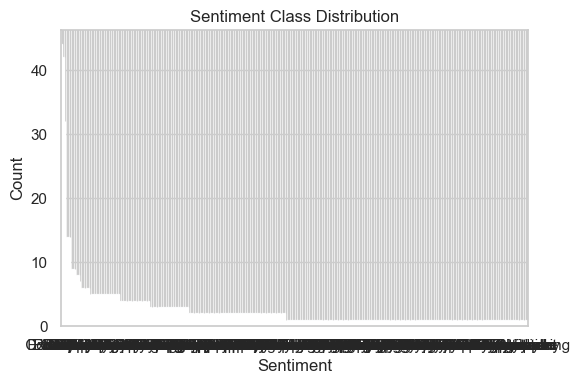

In [6]:
# Plot class distribution

plt.figure(figsize=(6,4))
df['Sentiment'].value_counts().plot(kind='bar')
plt.title("Sentiment Class Distribution")
plt.xlabel("Sentiment")
plt.ylabel("Count")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


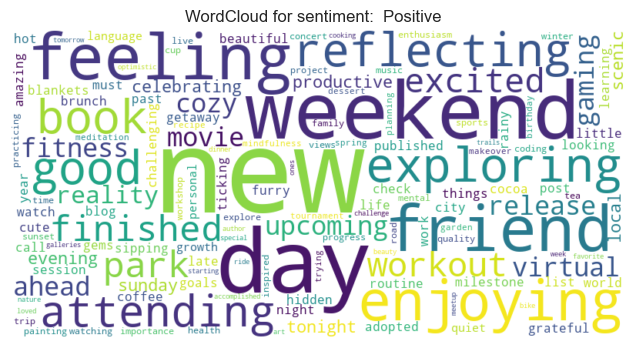

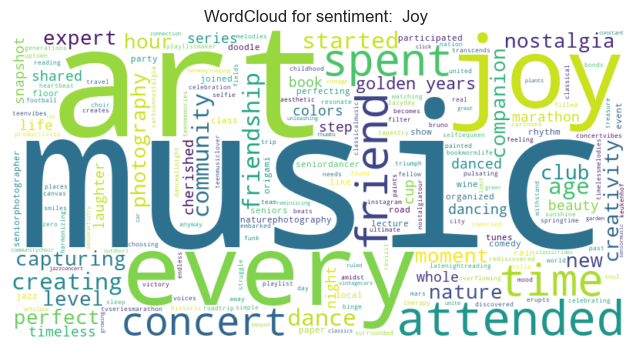

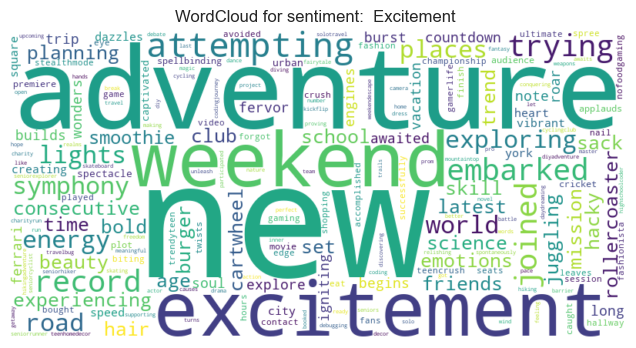

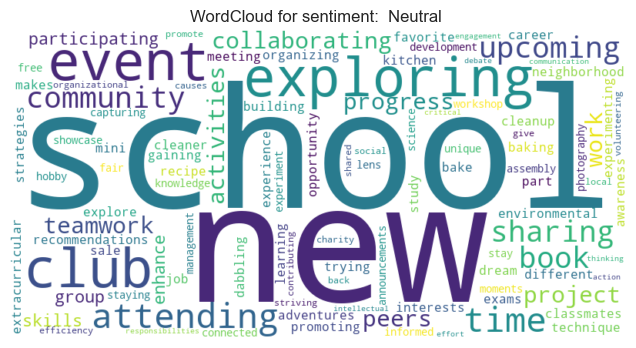

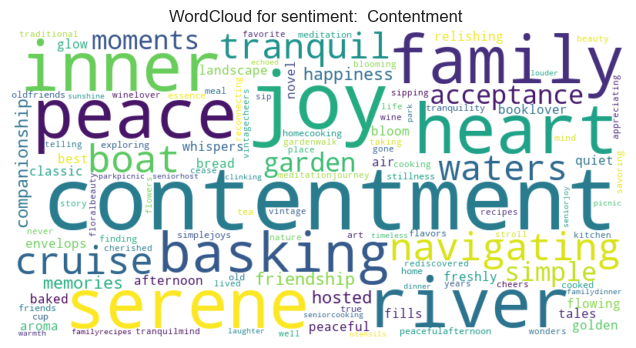

...

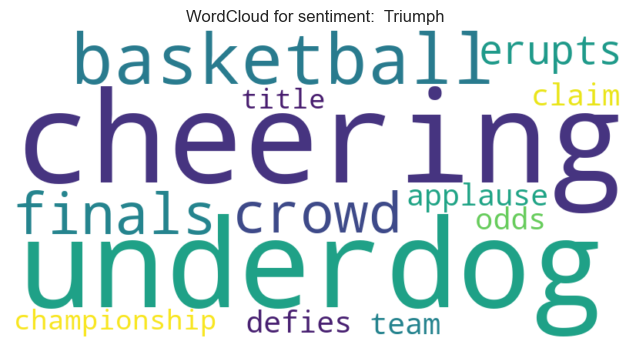

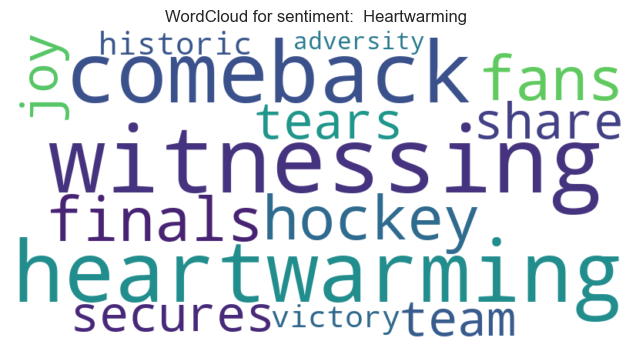

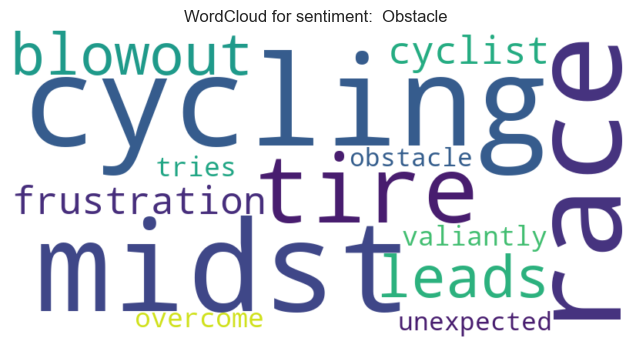

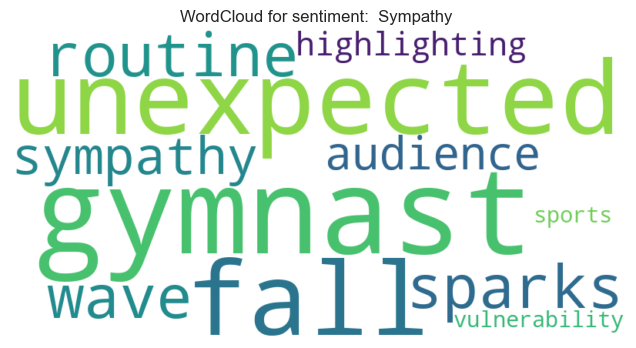

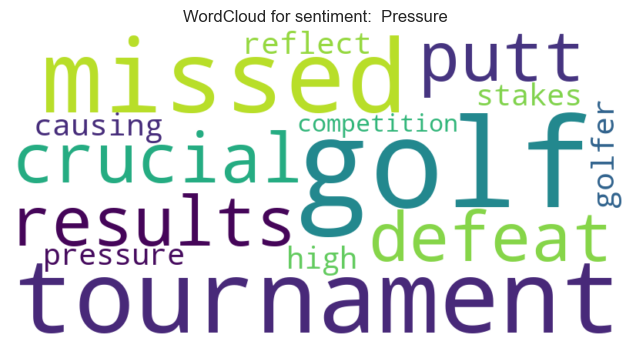

In [7]:
# Simple WordCloud for each sentiment

stop_words = set(stopwords.words('english'))

def clean_for_wordcloud(text):
    text = str(text).lower()
    text = re.sub(r"http\S+|www.\S+", " ", text)    # remove urls
    text = re.sub(r"@\w+|#", " ", text)            # remove mentions, hashtags
    text = re.sub(r"[^a-z\s]", " ", text)          # keep only letters
    text = re.sub(r"\s+", " ", text).strip()
    return text

sentiments_to_plot = df['Sentiment'].value_counts().index.tolist()

for s in sentiments_to_plot:
    subset = df[df['Sentiment'] == s]['Text'].astype(str).apply(clean_for_wordcloud)
    text_all = " ".join(subset.tolist())
    if len(text_all.strip()) == 0:
        continue
    wc = WordCloud(width=800, height=400, stopwords=stop_words, background_color='white').generate(text_all)
    plt.figure(figsize=(8,4))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"WordCloud for sentiment: {s}")
    plt.show()


In [8]:
# Text preprocessing / cleaning

stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    text = str(text).lower()
    # remove URLs
    text = re.sub(r"http\S+|www.\S+", " ", text)
    # remove mentions and hashtags
    text = re.sub(r"@\w+|#\w+", " ", text)
    # remove digits and punctuation, only letters and spaces
    text = re.sub(r"[^a-z\s]", " ", text)
    # remove extra spaces
    text = re.sub(r"\s+", " ", text).strip()
    # remove stopwords
    words = [w for w in text.split() if w not in stop_words]
    return " ".join(words)

df['clean_text'] = df['Text'].astype(str).apply(preprocess_text)

df[['Text', 'clean_text', 'Sentiment']].head()


,Text,clean_text,Sentiment
0,Enjoying a beautiful day at the park! ...,enjoying beautiful day park,Positive
1,Traffic was terrible this morning. ...,traffic terrible morning,Negative
2,Just finished an amazing workout! 💪 ...,finished amazing workout,Positive
3,Excited about the upcoming weekend getaway! ...,excited upcoming weekend getaway,Positive
4,Trying out a new recipe for dinner tonight. ...,trying new recipe dinner tonight,Neutral


In [9]:
# Handle rare classes and  train-test split and label encoding

# Any sentiment with count < 2 will be grouped as "Other"
min_count = 2
value_counts = df['Sentiment'].value_counts()

rare_classes = value_counts[value_counts < min_count].index
print("Rare classes being merged into 'Other':", list(rare_classes))

df['Sentiment'] = df['Sentiment'].replace(rare_classes, 'Other')

print("\nNew sentiment value counts after merging rare classes:")
print(df['Sentiment'].value_counts())


X = df['clean_text']
y = df['Sentiment']

# Stratified split so each (remaining) sentiment has at least 2 samples
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

print("\nTrain size:", X_train.shape[0])
print("Test size:", X_test.shape[0])

# Label encode sentiments
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
y_train_enc = label_encoder.fit_transform(y_train)
y_test_enc = label_encoder.transform(y_test)

print("\nEncoded classes:", list(label_encoder.classes_))


Rare classes being merged into 'Other': [' Confusion ', ' Shame ', ' Compassion', ' Elation   ', ' Loneliness      ', ' Anxiety         ', ' Renewed Effort ', ' Miscalculation ', ' Challenge ', ' Solace ', ' Breakthrough ', ' Harmony ', ' Joy in Baking ', ' Envisioning History ', ' Imagination ', ' Vibrancy ', ' Mesmerizing ', ' Culinary Adventure ', ' Winter Magic ', ' Thrilling Journey ', " Nature's Beauty ", ' Celestial Wonder ', ' Creative Inspiration ', ' Runway Creativity ', " Ocean's Freedom ", ' Whispers of the Past ', ' Boredom ', ' Indifference ', ' Disgust ', ' Relief ', ' Positive ', ' Euphoria   ', ' Melodic       ', ' FestiveJoy    ', ' InnerJourney  ', ' Freedom       ', ' Dazzle        ', ' Adrenaline     ', ' Harmony       ', ' ArtisticBurst ', ' Radiance      ', ' Wonder       ', ' Inspiration  ', ' CulinaryOdyssey ', ' Euphoria     ', ' Curiosity  ', ' Resilience   ', ' Immersion ', ' Spark        ', ' Gratitude    ', ' Marvel       ', ' Serenity   ', ' Heartbreak   

In [10]:
# Cell 10: TF-IDF vectorization

tfidf_vectorizer = TfidfVectorizer(
    max_features=15000,
    ngram_range=(1, 2),    # uni- and bi-grams
    min_df=2,
    max_df=0.95
)

X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

print("TF-IDF train shape:", X_train_tfidf.shape)
print("TF-IDF test shape:", X_test_tfidf.shape)


TF-IDF train shape: (585, 1207)
TF-IDF test shape: (147, 1207)


In [11]:
# Evaluating model 

def evaluate_model(y_true_enc, y_pred_enc, model_name="Model"):
    """
    y_true_enc, y_pred_enc: encoded integer labels (as in y_train_enc, y_test_enc)
    """
    # Basic metrics on encoded labels
    acc = accuracy_score(y_true_enc, y_pred_enc)
    f1_macro = f1_score(y_true_enc, y_pred_enc, average='macro')

    print(f"=== {model_name} ===")
    print(f"Accuracy: {acc:.4f}")
    print(f"Macro F1: {f1_macro:.4f}")
    print("\nClassification Report (using original sentiment names):")

    # Convert back to original sentiment names
    y_true_labels = label_encoder.inverse_transform(y_true_enc)
    y_pred_labels = label_encoder.inverse_transform(y_pred_enc)

    # Let classification_report handle labels automatically
    print(classification_report(y_true_labels, y_pred_labels))

    return acc, f1_macro


In [12]:
# Train and evaluate classical ML models

models = {
    "Logistic Regression": LogisticRegression(
        max_iter=1000,
        class_weight='balanced',
        n_jobs=-1
    ),
    "Linear SVM": LinearSVC(class_weight='balanced'),
    "Multinomial NB": MultinomialNB(),
    "Random Forest": RandomForestClassifier(
        n_estimators=200,
        max_depth=None,
        random_state=42,
        n_jobs=-1
    )
}

results = []

for name, model in models.items():
    print("\n" + "="*60)
    print(f"Training {name}...")
    model.fit(X_train_tfidf, y_train_enc)
    y_pred = model.predict(X_test_tfidf)
    acc, f1_macro = evaluate_model(y_test_enc, y_pred, model_name=name)
    results.append({"model": name, "accuracy": acc, "f1_macro": f1_macro})

results_df = pd.DataFrame(results).sort_values(by="f1_macro", ascending=False)
print("\nSummary of classical models:")
results_df



Training Logistic Regression...
=== Logistic Regression ===
Accuracy: 0.3333
Macro F1: 0.3068

Classification Report (using original sentiment names):
                   precision    recall  f1-score   support

    Acceptance          0.00      0.00      0.00         1
 Acceptance             0.50      1.00      0.67         1
  Accomplishment        0.00      0.00      0.00         1
    Adoration           1.00      1.00      1.00         1
       Adventure        0.00      0.00      0.00         1
 Ambivalence            1.00      1.00      1.00         1
    Amusement           0.00      0.00      0.00         0
    Anger               0.00      0.00      0.00         0
    Anticipation        0.00      0.00      0.00         0
   Arousal              0.25      1.00      0.40         1
             Awe        0.00      0.00      0.00         1
    Awe                 0.00      0.00      0.00         0
             Bad        1.00      1.00      1.00         1
        Betrayal     

,model,accuracy,f1_macro
3,Random Forest,0.401361,0.380916
1,Linear SVM,0.380952,0.362913
0,Logistic Regression,0.333333,0.306838
2,Multinomial NB,0.204082,0.006367


## Model Training and comparision

Best classical model: Random Forest
model       Random Forest
accuracy         0.401361
f1_macro         0.380916
Name: 3, dtype: object


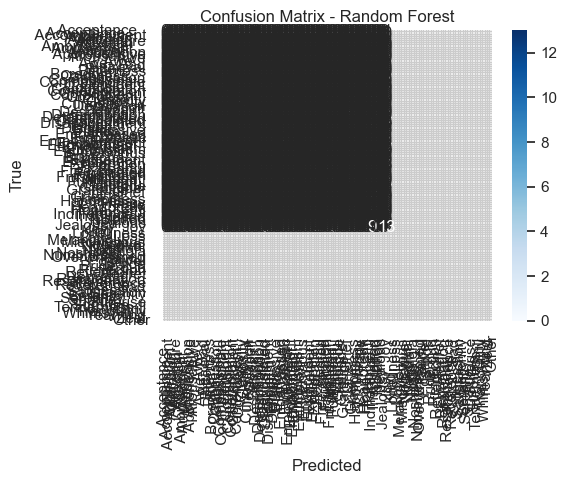

In [13]:
# Best classical model and confusion matrix

best_row = results_df.iloc[0]
best_model_name = best_row['model']
best_model = models[best_model_name]

print(f"Best classical model: {best_model_name}")
print(best_row)

# Confusion matrix
y_pred_best = best_model.predict(X_test_tfidf)
cm = confusion_matrix(y_test_enc, y_pred_best)

plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_,
            cmap="Blues")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title(f"Confusion Matrix - {best_model_name}")
plt.tight_layout()
plt.show()


In [14]:
# Saving best classical model and TF-IDF vectorizer

import joblib

joblib.dump(best_model, "best_classical_model.pkl")
joblib.dump(tfidf_vectorizer, "tfidf_vectorizer.pkl")
joblib.dump(label_encoder, "label_encoder.pkl")

print("Saved best_classical_model.pkl, tfidf_vectorizer.pkl, label_encoder.pkl")


Saved best_classical_model.pkl, tfidf_vectorizer.pkl, label_encoder.pkl


In [15]:
# Preparing data for deep learning (tokenization & padding)

max_words = 10000     # size of vocabulary
max_len = 50          # max sequence length

tokenizer = Tokenizer(num_words=max_words, oov_token="<OOV>")
tokenizer.fit_on_texts(X_train)

X_train_seq = tokenizer.texts_to_sequences(X_train)
X_test_seq = tokenizer.texts_to_sequences(X_test)

X_train_pad = pad_sequences(X_train_seq, maxlen=max_len, padding='post', truncating='post')
X_test_pad = pad_sequences(X_test_seq, maxlen=max_len, padding='post', truncating='post')

num_classes = len(label_encoder.classes_)

print("Padded train shape:", X_train_pad.shape)
print("Padded test shape:", X_test_pad.shape)
print("Number of classes:", num_classes)


Padded train shape: (585, 50)
Padded test shape: (147, 50)
Number of classes: 135


In [16]:
# BiLSTM deep learning model

embedding_dim = 128

lstm_model = Sequential([
    Embedding(input_dim=max_words, output_dim=embedding_dim, input_length=max_len),
    Bidirectional(LSTM(64, return_sequences=False)),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(num_classes, activation='softmax')
])

lstm_model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

lstm_model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape          ┃      Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━┩
│ embedding (Embedding)         │ ?                     │  0 (unbuilt) │
├───────────────────────────────┼───────────────────────┼──────────────┤
│ bidirectional (Bidirectional) │ ?                     │  0 (unbuilt) │
├───────────────────────────────┼───────────────────────┼──────────────┤
│ dropout (Dropout)             │ ?                     │            0 │
├───────────────────────────────┼───────────────────────┼──────────────┤
│ dense (Dense)                 │ ?                     │  0 (unbuilt) │
├───────────────────────────────┼───────────────────────┼──────────────┤
│ dropout_1 (Dropout)           │ ?                     │            0 │
├───────────────────────────────┼───────────────────────┼──────────────┤
│ dense_1 (Dense)               │ ?                     │  0 (unbuilt) │
└───────────────────────────────┴───────────────────────┴──────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [17]:
# Training BiLSTM model

batch_size = 32
epochs = 10

history = lstm_model.fit(
    X_train_pad,
    y_train_enc,
    validation_split=0.2,
    epochs=epochs,
    batch_size=batch_size,
    verbose=1
)


Epoch 1/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 17s 195ms/step - accuracy: 0.1239 - loss: 4.8603 - val_accuracy: 0.1880 - val_loss: 4.7498
Epoch 2/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.1987 - loss: 4.5180 - val_accuracy: 0.1880 - val_loss: 4.4858
Epoch 3/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.1987 - loss: 4.3070 - val_accuracy: 0.1880 - val_loss: 4.4146
Epoch 4/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.2030 - loss: 4.2463 - val_accuracy: 0.1880 - val_loss: 4.3926
Epoch 5/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - accuracy: 0.2030 - loss: 4.1536 - val_accuracy: 0.1880 - val_loss: 4.3725
Epoch 6/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step - accuracy: 0.1987 - loss: 4.1280 - val_accuracy: 0.1880 - val_loss: 4.3535
Epoch 7/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step - accuracy: 0.1987 - loss: 4.0229 - val_accuracy: 0.1880 - val_loss: 4.3259
Epoch 8/10
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step - accuracy: 0.2030 - loss: 3.8758 - val_accuracy: 0.1880 -

In [18]:
# Evaluating BiLSTM model

# Accuracy on test set
test_loss, test_acc = lstm_model.evaluate(X_test_pad, y_test_enc, verbose=0)
print(f"BiLSTM Test Accuracy: {test_acc:.4f}")

# Predictions
y_pred_proba_dl = lstm_model.predict(X_test_pad)
y_pred_dl = np.argmax(y_pred_proba_dl, axis=1)

# Metrics
dl_acc, dl_f1_macro = evaluate_model(y_test_enc, y_pred_dl, model_name="BiLSTM Deep Learning Model")

# Add deep learning results to summary dataframe
results_df = pd.concat(
    [results_df, pd.DataFrame([{
        "model": "BiLSTM",
        "accuracy": dl_acc,
        "f1_macro": dl_f1_macro
    }])],
    ignore_index=True
)

results_df


BiLSTM Test Accuracy: 0.1701
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step
=== BiLSTM Deep Learning Model ===
Accuracy: 0.1701
Macro F1: 0.0085

Classification Report (using original sentiment names):
                   precision    recall  f1-score   support

    Acceptance          0.00      0.00      0.00         1
 Acceptance             0.00      0.00      0.00         1
  Accomplishment        0.00      0.00      0.00         1
    Adoration           0.00      0.00      0.00         1
       Adventure        0.00      0.00      0.00         1
 Ambivalence            0.00      0.00      0.00         1
   Arousal              0.00      0.00      0.00         1
             Awe        0.00      0.00      0.00         1
             Bad        0.00      0.00      0.00         1
        Betrayal        0.00      0.00      0.00         1
    Bitter              0.00      0.00      0.00         1
      Bitterness        0.00      0.00      0.00         1
 Boredom                0.00      0.00

,model,accuracy,f1_macro
0,Random Forest,0.401361,0.380916
1,Linear SVM,0.380952,0.362913
2,Logistic Regression,0.333333,0.306838
3,Multinomial NB,0.204082,0.006367
4,BiLSTM,0.170068,0.008511


In [19]:
# Save BiLSTM model and tokenizer

lstm_model.save("bilstm_sentiment_model.h5")

import pickle
with open("tokenizer.pkl", "wb") as f:
    pickle.dump(tokenizer, f)
print("Saved bilstm_sentiment_model.h5 and tokenizer.pkl")


Saved bilstm_sentiment_model.h5 and tokenizer.pkl


In [20]:
# Prediction helper functions

def predict_sentiment_classical(text):
    """Predict sentiment using the best classical model (TF-IDF + best_model)."""
    cleaned = preprocess_text(text)
    vec = tfidf_vectorizer.transform([cleaned])
    pred_enc = best_model.predict(vec)[0]
    pred_label = label_encoder.inverse_transform([pred_enc])[0]
    return pred_label

def predict_sentiment_bilstm(text):
    """Predict sentiment using the BiLSTM deep learning model."""
    cleaned = preprocess_text(text)
    seq = tokenizer.texts_to_sequences([cleaned])
    pad = pad_sequences(seq, maxlen=max_len, padding='post', truncating='post')
    proba = lstm_model.predict(pad)[0]
    pred_enc = np.argmax(proba)
    pred_label = label_encoder.inverse_transform([pred_enc])[0]
    return pred_label, proba

# Quick test
sample_text = "I really love this new product, it's amazing!"
print("Classical prediction:", predict_sentiment_classical(sample_text))
pred_label_dl, proba_dl = predict_sentiment_bilstm(sample_text)
print("BiLSTM prediction:", pred_label_dl)


Classical prediction:  Positive  
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
BiLSTM prediction:  Positive  


# ✅ Conclusion

In this project, a complete **end-to-end Sentiment Analysis system** was successfully developed using both **Machine Learning and Deep Learning approaches**. The project covered all major stages of a real-world data science workflow, including:

- Data loading, cleaning, and preprocessing of text data.
- Feature extraction using TF-IDF Vectorization.
- Training and evaluation of multiple Machine Learning models.
- Building and evaluating a Deep Learning model using BiLSTM.
- Comparing all models using Accuracy and Macro F1-Score.
- Selecting the best-performing model for deployment.
- Creating a real-time **Streamlit web application** for sentiment prediction.

The results clearly show that proper preprocessing, effective feature extraction, and correct model selection play a crucial role in building a reliable sentiment classification system.

This project provided strong hands-on experience in:
- Natural Language Processing (NLP)
- Machine Learning model development
- Deep Learning using LSTM
- Model evaluation and comparison
- Real-world model deployment using Streamlit

Overall, this project successfully fulfills its objectives and demonstrates a solid practical understanding of **Data Science, Machine Learning, Deep Learning, and Model Deployment**, making it highly suitable for **Data Science and AI/ML internship roles**.
